# Download and Process the Data

In [ ]:
#@title Download the dataset
!gdown 1cdmd2hsJp9nUpM94edjNgo92srMj9Adw

Downloading...
From: https://drive.google.com/uc?id=1cdmd2hsJp9nUpM94edjNgo92srMj9Adw
To: /content/data.csv
100% 636k/636k [00:00<00:00, 9.38MB/s]


In [ ]:
#@title Read the dataset from the csv file
import pandas as pd
import numpy as np
df = pd.read_csv('data.csv')
df

,Wellhead_Temp,Wellhead_Press,MMCFD_gas,BOPD,BWPD,BSW _ basic_solid_and_water,CO2_mol,Gas_Grav,CR_corrosion_defect
0,53.35,1105.13,12.87,1378.93,2812.62,75.64,3.3628,0.7205,0.2245
1,72.25,1026.31,3.42,1028.75,919.92,44.21,3.8679,0.8940,0.2262
2,65.08,722.96,6.23,2017.92,1212.42,17.55,2.3552,0.7661,0.2305
3,60.71,1557.23,11.71,558.22,1716.09,65.79,1.7253,0.7738,0.2303
4,46.19,1304.42,8.58,1280.47,1929.22,37.45,1.8327,0.7611,0.2202
...,...,...,...,...,...,...,...,...,...
10287,56.81,2242.44,1.71,1470.60,5929.47,14.83,2.0084,0.7927,0.0031
10288,47.46,2243.44,2.42,727.07,4184.95,37.04,2.5155,0.7695,0.0027
10289,54.03,2286.86,1.50,967.96,4900.59,7.84,3.7564,0.8991,0.0027
10290,45.69,1674.08,3.42,1312.84,3476.96,23.08,3.8039,0.7940,0.0022


In [ ]:
#@title Create the Classification Target from the Corrosion defect column values
df['target'] = np.where(df['CR_corrosion_defect'] <= 0.211, 0, 1)
df

,Wellhead_Temp,Wellhead_Press,MMCFD_gas,BOPD,BWPD,BSW _ basic_solid_and_water,CO2_mol,Gas_Grav,CR_corrosion_defect,target
0,53.35,1105.13,12.87,1378.93,2812.62,75.64,3.3628,0.7205,0.2245,1
1,72.25,1026.31,3.42,1028.75,919.92,44.21,3.8679,0.8940,0.2262,1
2,65.08,722.96,6.23,2017.92,1212.42,17.55,2.3552,0.7661,0.2305,1
3,60.71,1557.23,11.71,558.22,1716.09,65.79,1.7253,0.7738,0.2303,1
4,46.19,1304.42,8.58,1280.47,1929.22,37.45,1.8327,0.7611,0.2202,1
...,...,...,...,...,...,...,...,...,...,...
10287,56.81,2242.44,1.71,1470.60,5929.47,14.83,2.0084,0.7927,0.0031,0
10288,47.46,2243.44,2.42,727.07,4184.95,37.04,2.5155,0.7695,0.0027,0
10289,54.03,2286.86,1.50,967.96,4900.59,7.84,3.7564,0.8991,0.0027,0
10290,45.69,1674.08,3.42,1312.84,3476.96,23.08,3.8039,0.7940,0.0022,0


In [ ]:
#@title Normalize the first 8 features of the dataset
df.iloc[:, 0:8] = (df.iloc[:, 0:8] - df.iloc[:, 0:8].min()) / (df.iloc[:, 0:8].max() - df.iloc[:, 0:8].min())
df


,Wellhead_Temp,Wellhead_Press,MMCFD_gas,BOPD,BWPD,BSW _ basic_solid_and_water,CO2_mol,Gas_Grav,CR_corrosion_defect,target
0,0.374390,0.373640,0.730214,0.638144,0.298913,0.847189,0.741574,0.042572,0.2245,1
1,0.950610,0.332910,0.184287,0.459294,0.094818,0.494559,0.881119,0.828351,0.2262,1
2,0.732012,0.176152,0.346620,0.964499,0.126359,0.195445,0.463200,0.249094,0.2305,1
3,0.598780,0.607266,0.663200,0.218978,0.180671,0.736677,0.289176,0.283967,0.2303,1
4,0.156098,0.476625,0.482380,0.587857,0.203653,0.418714,0.318847,0.226449,0.2202,1
...,...,...,...,...,...,...,...,...,...,...
10287,0.479878,0.961352,0.085500,0.684963,0.635010,0.164928,0.367389,0.369565,0.0031,0
10288,0.194817,0.961869,0.126516,0.305216,0.446894,0.414114,0.507487,0.264493,0.0027,0
10289,0.395122,0.984306,0.073368,0.428247,0.524063,0.086503,0.850315,0.851449,0.0027,0
10290,0.140854,0.667649,0.184287,0.604389,0.370550,0.257489,0.863438,0.375453,0.0022,0


In [ ]:
#@title Defining the Training and Testing Set
X = df.iloc[:, :8].values
y = df['target'].values

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], 1)

In [ ]:
#@title Training the model

from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense
import tensorflow as tf
from tensorflow.keras.optimizers import Adam,SGD

model = Sequential()
model.add(Conv1D(filters=32, kernel_size=2, padding='same', activation='relu', input_shape=(8, 1)))
model.add(MaxPooling1D(pool_size=2))
# model.add(Conv1D(filters=64, kernel_size=2, padding='same', activation='relu'))
# model.add(MaxPooling1D(pool_size=2))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])

history = model.fit(X_train, y_train,validation_data=(X_test,y_test), epochs=100, batch_size=32)


Epoch 1/100
258/258 [==============================] - 2s 3ms/step - loss: 0.5637 - accuracy: 0.7081 - val_loss: 0.4862 - val_accuracy: 0.7693
Epoch 2/100
258/258 [==============================] - 1s 3ms/step - loss: 0.4418 - accuracy: 0.7930 - val_loss: 0.4262 - val_accuracy: 0.7955
Epoch 3/100
258/258 [==============================] - 1s 4ms/step - loss: 0.3804 - accuracy: 0.8280 - val_loss: 0.3691 - val_accuracy: 0.8412
Epoch 4/100
258/258 [==============================] - 1s 4ms/step - loss: 0.3415 - accuracy: 0.8513 - val_loss: 0.4071 - val_accuracy: 0.8111
Epoch 5/100
258/258 [==============================] - 1s 3ms/step - loss: 0.3210 - accuracy: 0.8610 - val_loss: 0.3217 - val_accuracy: 0.8674
Epoch 6/100
258/258 [==============================] - 1s 3ms/step - loss: 0.2992 - accuracy: 0.8721 - val_loss: 0.2935 - val_accuracy: 0.8854
Epoch 7/100
258/258 [==============================] - 1s 2ms/step - loss: 0.2783 - accuracy: 0.8853 - val_loss: 0.3291 - val_accuracy: 0.8572

65/65 [==============================] - 0s 1ms/step


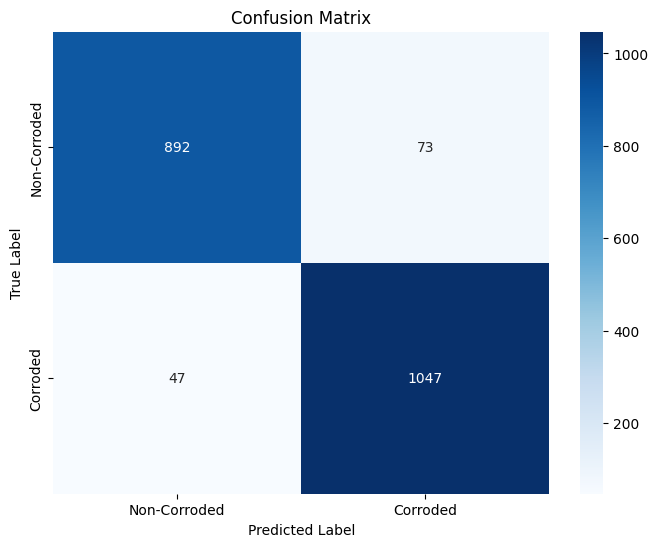

In [ ]:
#@title Confusion Matrix
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, accuracy_score

y_pred = model.predict(X_test)
y_pred = (y_pred > 0.5)

# Generate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Define class labels
class_labels = ['Non-Corroded', 'Corroded']

# Plot the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()


In [ ]:
#@title Test Accuracy Precision Recall and F1 Score
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, y_pred)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, y_pred)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, y_pred)
print('F1 score: %f' % f1)
pd.DataFrame({
    "Accuracy": [accuracy],
    "Precision": [precision],
    "Recall": [recall],
    "F1 Score": [f1]
})

Accuracy: 0.941719
Precision: 0.934821
Recall: 0.957038
F1 score: 0.945799


,Accuracy,Precision,Recall,F1 Score
0,0.941719,0.934821,0.957038,0.945799


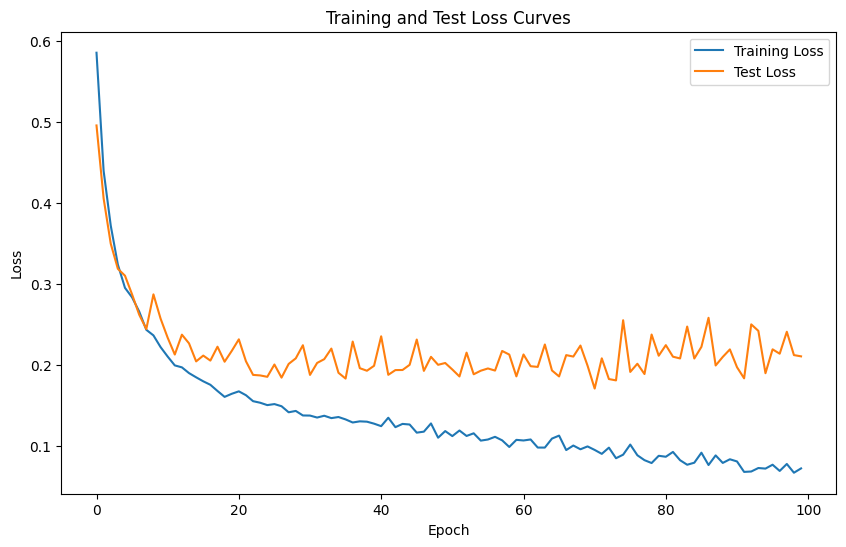

In [ ]:
#@title Plot the training and validation loss curves

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Test Loss')
plt.title('Training and Test Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


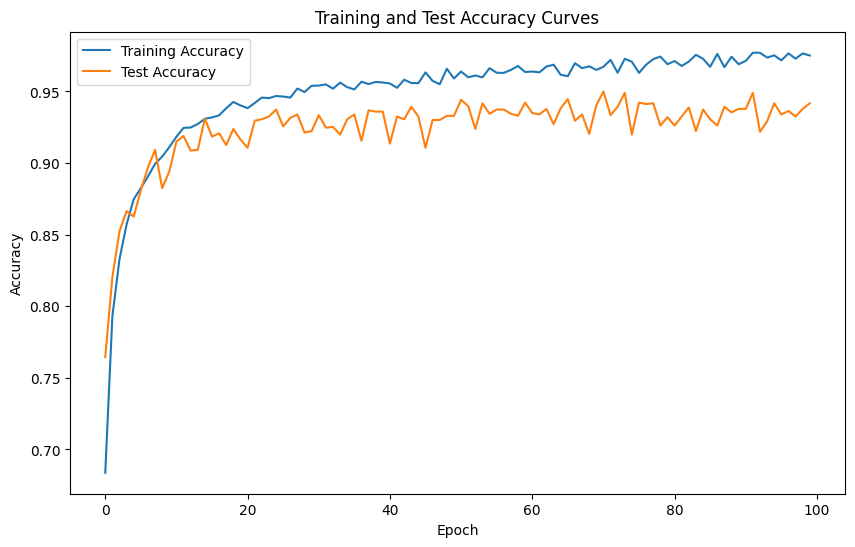

In [ ]:
#@title Plot the training and validation accuracy curves

plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Test Accuracy')
plt.title('Training and Test Accuracy Curves')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


<ipython-input-35-389881161051>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = df['target'], y = df['CR_corrosion_defect'], palette = ['blue', 'orange'])


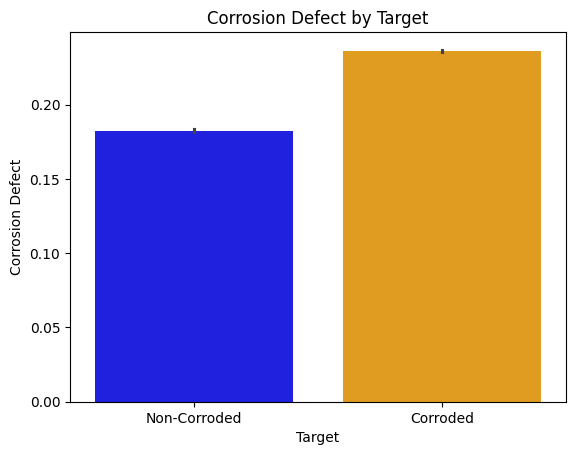

In [ ]:
#@title Histogram of the Categories in the data
import matplotlib.pyplot as plt
sns.barplot(x = df['target'], y = df['CR_corrosion_defect'], palette = ['blue', 'orange'])
plt.xlabel('Target')
plt.ylabel('Corrosion Defect')
plt.title('Corrosion Defect by Target')
plt.xticks([0, 1], ['Non-Corroded', 'Corroded'])
plt.show()


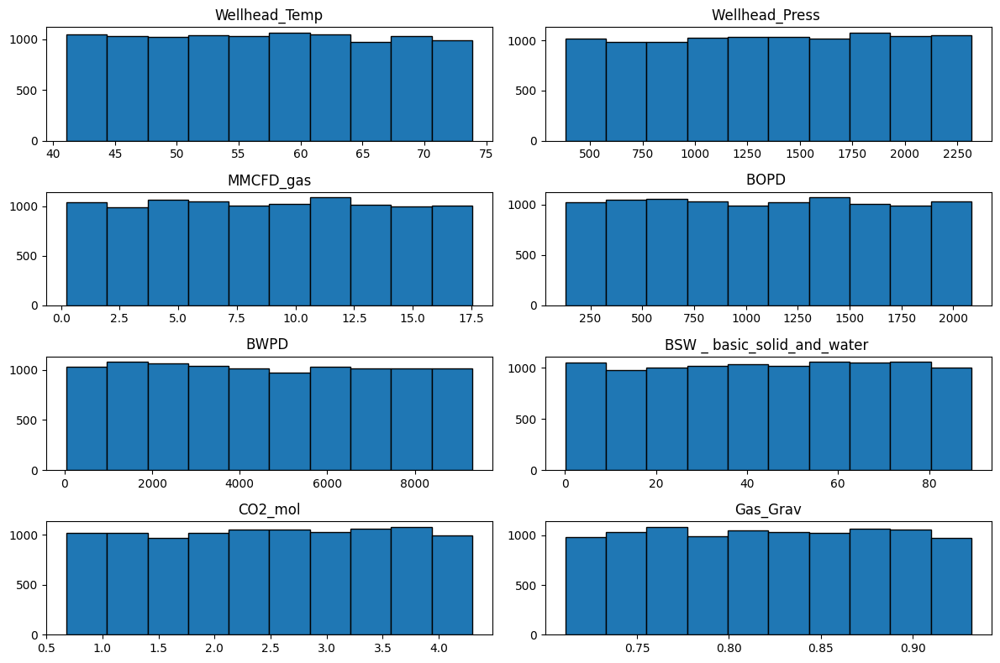

In [ ]:
#@title BarPlots of the different features of the data
import matplotlib.pyplot as plt

# Create a figure with 4 rows and 2 columns of subplots
fig, axes = plt.subplots(4, 2, figsize=(12, 8))

# Loop through the first 8 columns of the DataFrame
for i, col in enumerate(df.iloc[:, :8]):
    # Select the current subplot
    ax = axes[i // 2, i % 2]

    # Plot the histogram of the current column
    ax.hist(df[col], bins=10, edgecolor='black')

    # Set the title of the subplot
    ax.set_title(col)

# Adjust the spacing between subplots
plt.tight_layout()
# Show the plot
plt.show()



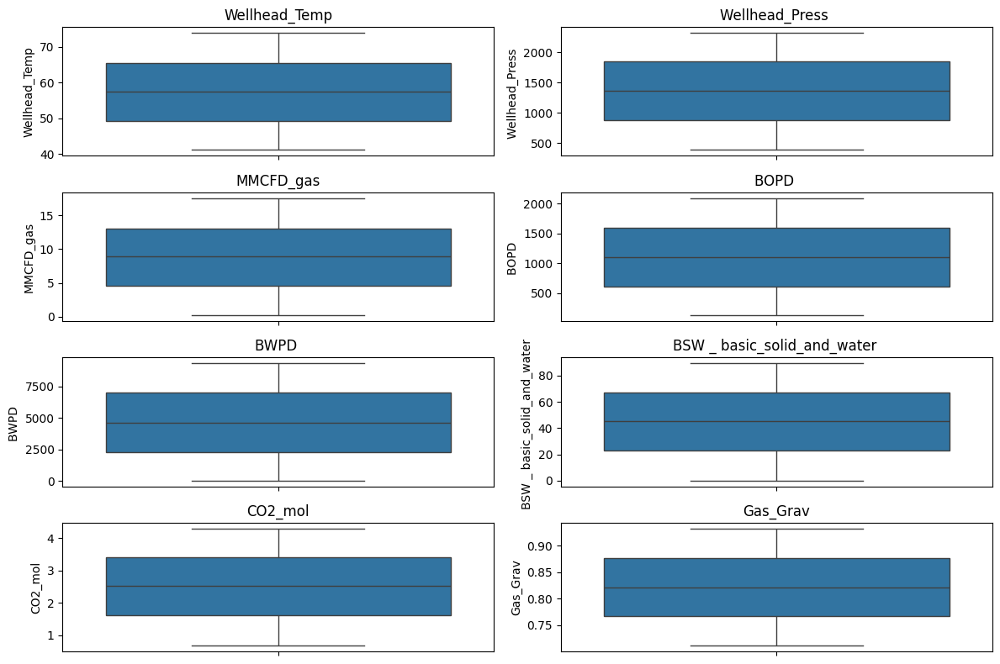

In [ ]:
#@title BoxPlots of the features
import matplotlib.pyplot as plt
import seaborn as sns

# Create a figure with 4 rows and 2 columns of subplots
fig, axes = plt.subplots(4, 2, figsize=(12, 8))

# Loop through the first 8 columns of the DataFrame
for i, col in enumerate(df.iloc[:, :8]):
    # Select the current subplot
    ax = axes[i // 2, i % 2]

    # Create a boxplot of the current column
    sns.boxplot(y=df[col], ax=ax)

    # Set the title of the subplot
    ax.set_title(col)

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


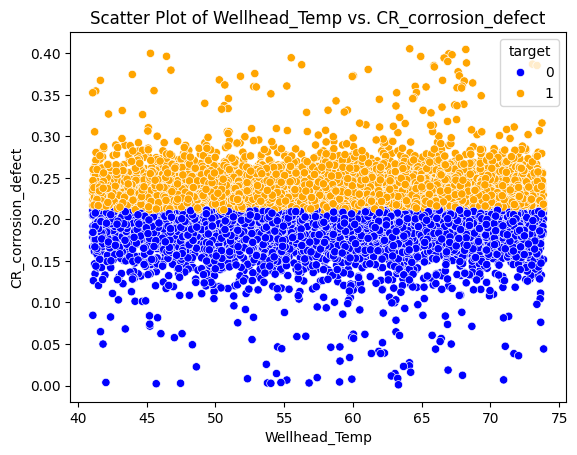

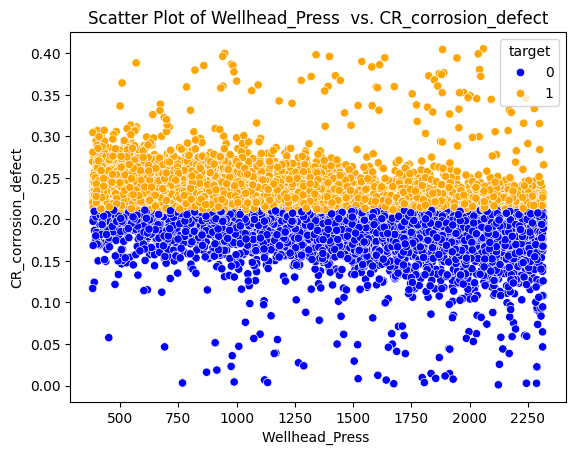

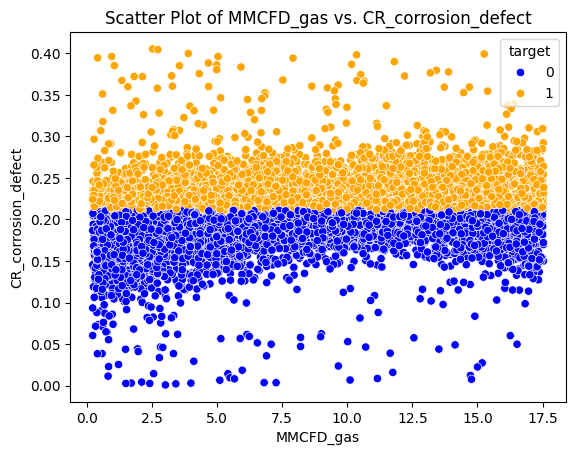

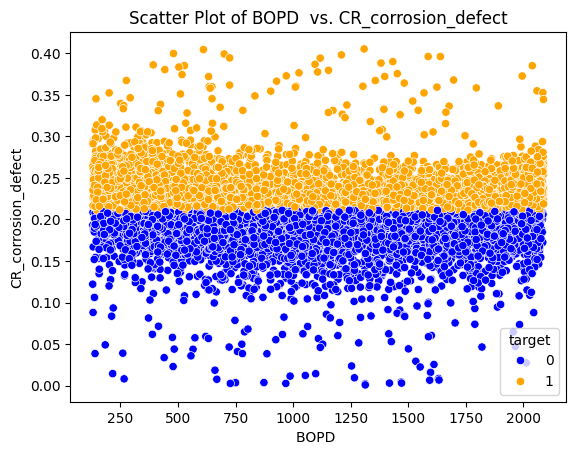

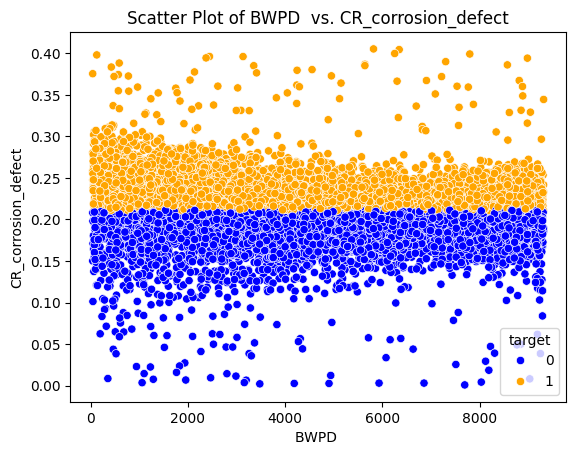

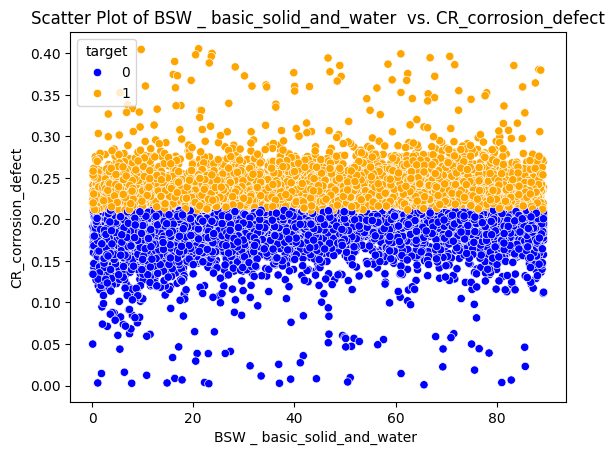

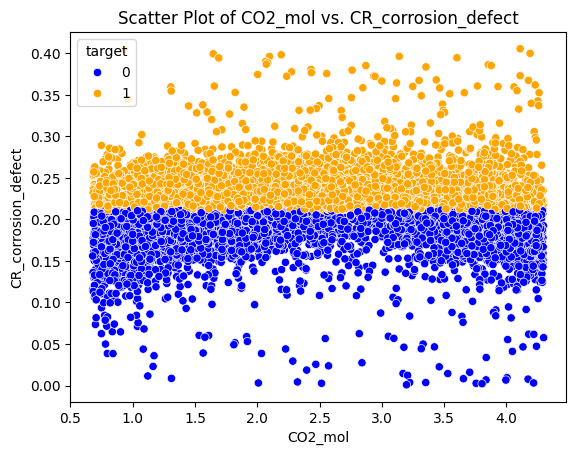

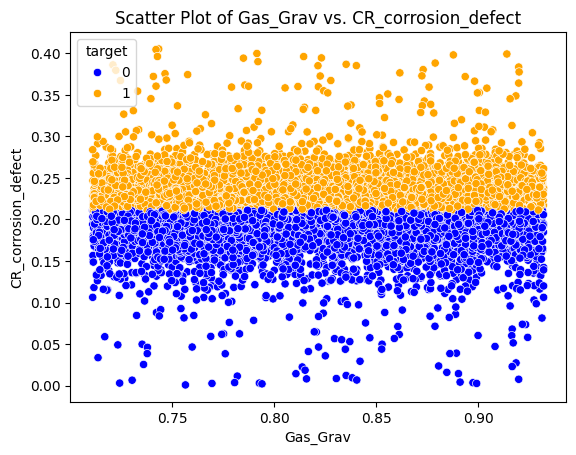

In [ ]:
#@title Scatter plots
import matplotlib.pyplot as plt
import seaborn as sns

# Define a list of colors for the target values
colors = ['blue', 'orange']

# Loop through the first 8 columns of the DataFrame
for i in range(8):
    # Create a figure
    plt.figure()

    # Create a scatter plot of the current column and the CR_corrosion_defect values
    sns.scatterplot(x=df.iloc[:, i], y=df['CR_corrosion_defect'], hue=df['target'], palette=colors)

    # Set the title of the plot
    plt.title(f'Scatter Plot of {df.columns[i]} vs. CR_corrosion_defect')

    # Show the plot
    plt.show()


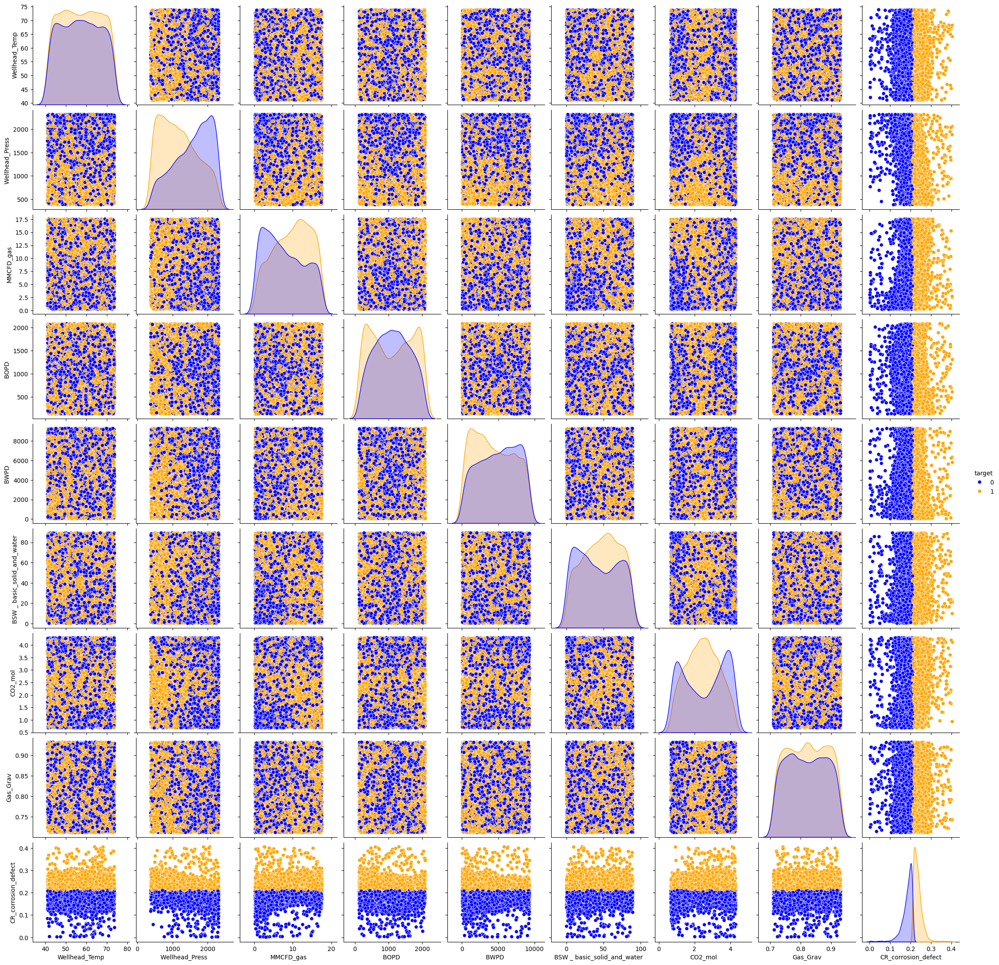

In [ ]:
#@title Pair Plots
import matplotlib.pyplot as plt
import seaborn as sns

# Create a pairplot of the first 8 columns of the DataFrame, colored by the target column
sns.pairplot(df, hue='target', palette=['blue', 'orange'])

# Show the plot
plt.show()


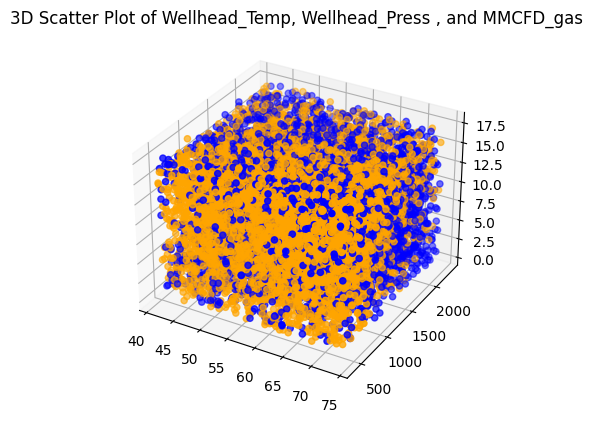

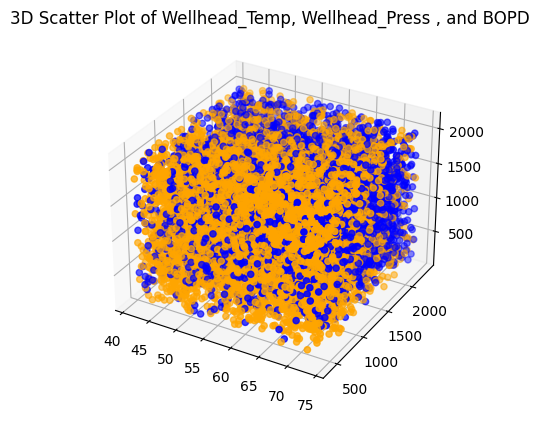

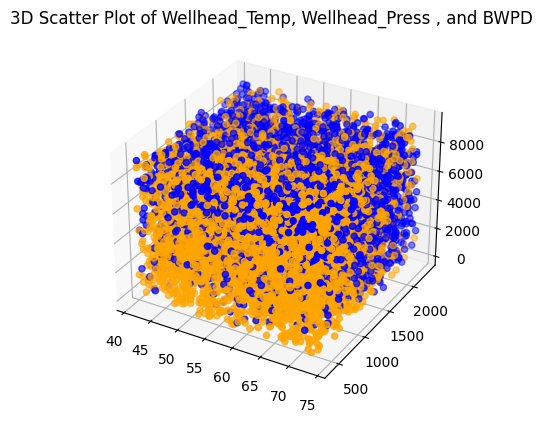

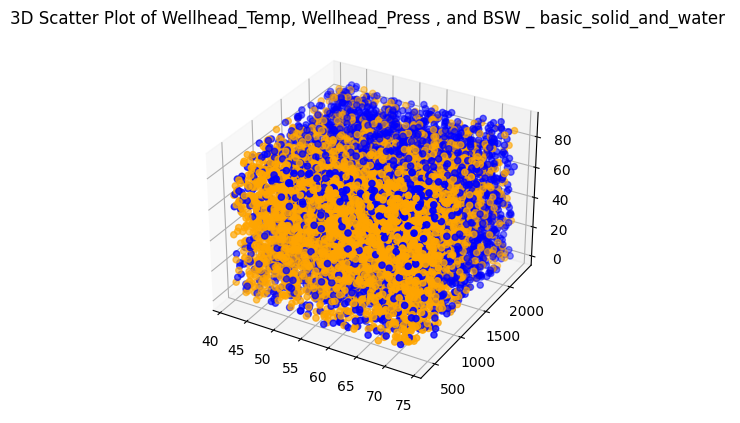

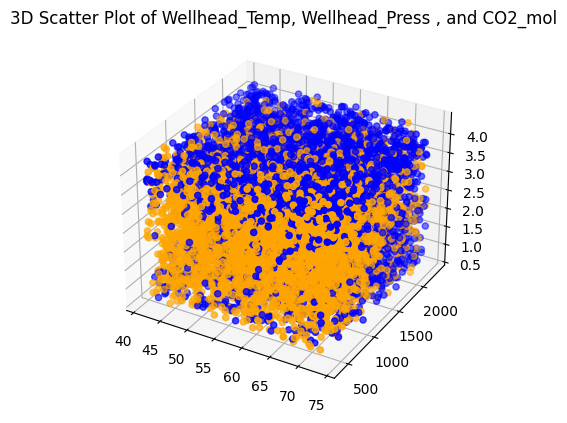

...

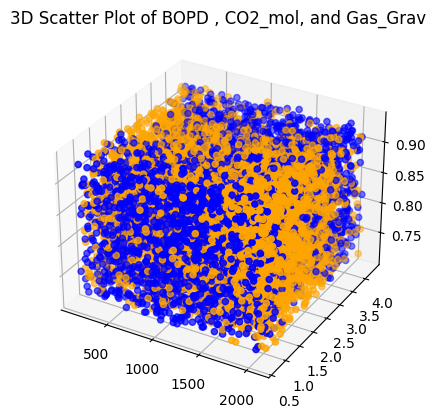

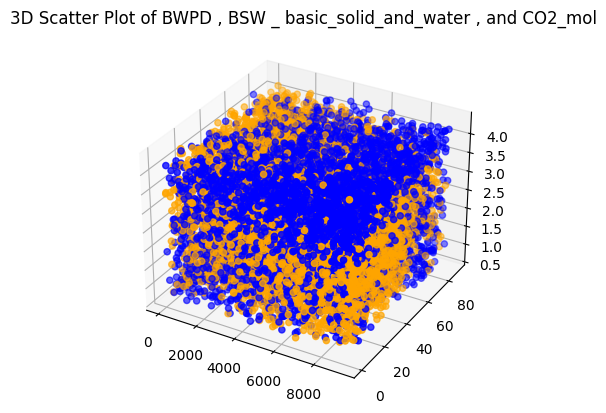

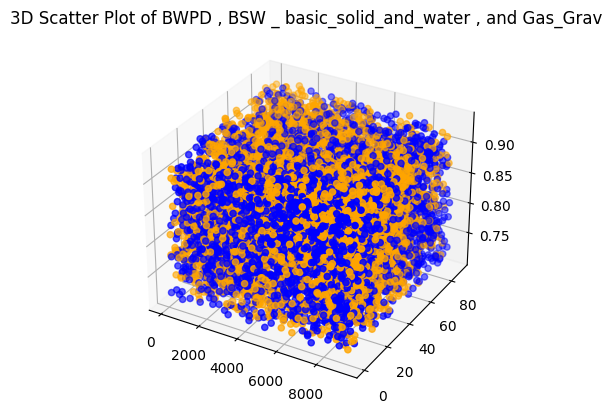

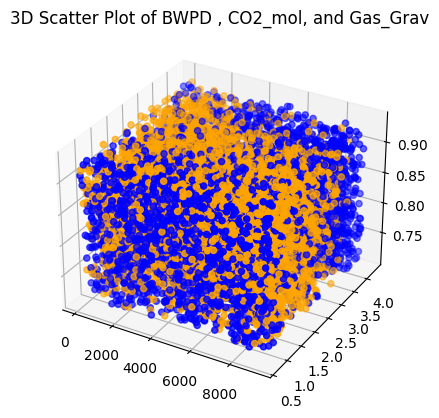

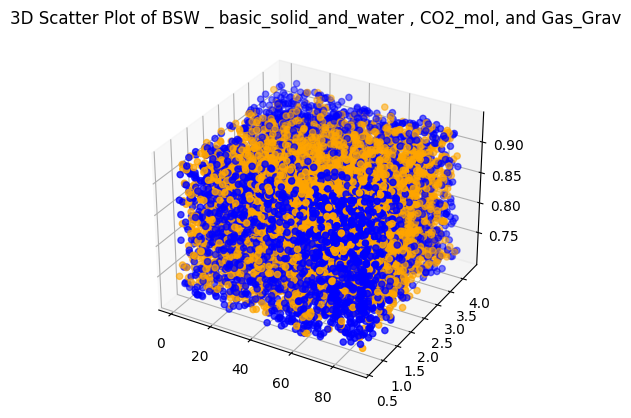

In [ ]:
#@title 3D Plots
import matplotlib.pyplot as plt

# Define a list of colors for the target values
colors = ['blue', 'orange']

# Loop through the first 8 columns of the DataFrame
for i in range(8):
    for j in range(i + 1, 8):
        for k in range(j + 1, 8):
            # Create a figure
            fig = plt.figure()

            # Create a 3D scatter plot of the current three columns and the target values
            ax = fig.add_subplot(111, projection='3d')
            ax.scatter(df.iloc[:, i], df.iloc[:, j], df.iloc[:, k], c=df['target'].apply(lambda x: colors[x]))

            # Set the title of the plot
            ax.set_title(f'3D Scatter Plot of {df.columns[i]}, {df.columns[j]}, and {df.columns[k]}')

            # Show the plot
            plt.show()


In [ ]:
#@title Correlation Matrix
df.corr()

,Wellhead_Temp,Wellhead_Press,MMCFD_gas,BOPD,BWPD,BSW _ basic_solid_and_water,CO2_mol,Gas_Grav,CR_corrosion_defect,target
Wellhead_Temp,1.000000,-0.006530,-0.010566,0.008170,-0.006123,-0.014964,-0.001089,0.019406,0.011787,0.006499
Wellhead_Press,-0.006530,1.000000,-0.023430,-0.023765,-0.015909,0.002189,-0.008868,-0.002049,-0.368941,-0.346670
MMCFD_gas,-0.010566,-0.023430,1.000000,-0.001589,-0.008429,-0.000596,-0.012253,0.004666,0.221468,0.196476
BOPD,0.008170,-0.023765,-0.001589,1.000000,0.008626,0.005770,-0.010193,0.004384,-0.036999,-0.004394
BWPD,-0.006123,-0.015909,-0.008429,0.008626,1.000000,-0.004737,0.003480,-0.018078,-0.123770,-0.125353
BSW _ basic_solid_and_water,-0.014964,0.002189,-0.000596,0.005770,-0.004737,1.000000,-0.012326,0.007574,0.123530,0.088270
CO2_mol,-0.001089,-0.008868,-0.012253,-0.010193,0.003480,-0.012326,1.000000,-0.023080,-0.013908,-0.054192
Gas_Grav,0.019406,-0.002049,0.004666,0.004384,-0.018078,0.007574,-0.023080,1.000000,0.005793,0.015844
CR_corrosion_defect,0.011787,-0.368941,0.221468,-0.036999,-0.123770,0.123530,-0.013908,0.005793,1.000000,0.720183
target,0.006499,-0.346670,0.196476,-0.004394,-0.125353,0.088270,-0.054192,0.015844,0.720183,1.000000


# **SVM**

In [ ]:
#@title Defining the Training and Testing Set
X = df.iloc[:, :8].values
y = df['target'].values

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], 1)

In [ ]:
#@title SVM Defining
from sklearn import svm

# Create an SVM classifier
clf = svm.SVC(kernel='rbf',gamma=0.1,C=1000)

# Train the classifier on the training data
clf.fit(X_train[:,:,0], y_train)

# Predict the labels of the test data
y_pred = clf.predict(X_test[:,:,0])


In [ ]:
#@title Test Accuracy Precision Recall and F1 Score
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, y_pred)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, y_pred)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, y_pred)
print('F1 score: %f' % f1)
pd.DataFrame({
    "Accuracy": [accuracy],
    "Precision": [precision],
    "Recall": [recall],
    "F1 Score": [f1]
})

Accuracy: 0.966003
Precision: 0.964610
Recall: 0.971664
F1 score: 0.968124


,Accuracy,Precision,Recall,F1 Score
0,0.966003,0.96461,0.971664,0.968124


65/65 [==============================] - 0s 1ms/step


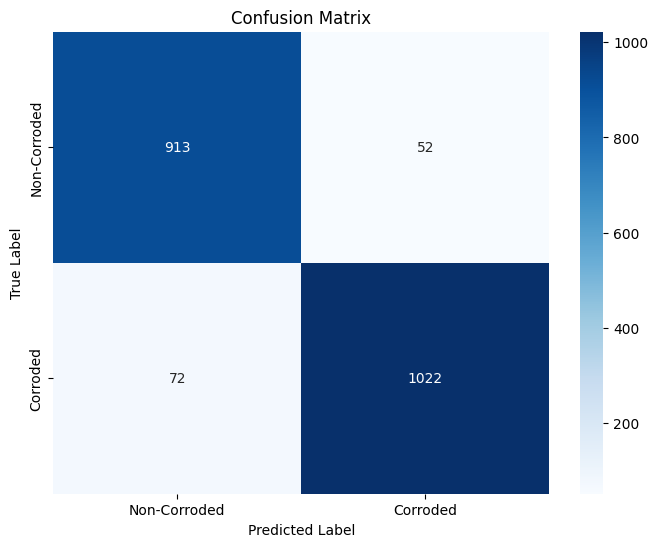

In [ ]:
#@title Confusion Matrix
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, accuracy_score

y_pred = model.predict(X_test)
y_pred = (y_pred > 0.5)

# Generate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Define class labels
class_labels = ['Non-Corroded', 'Corroded']

# Plot the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()
